Đã lưu kết quả: result_1.jpg


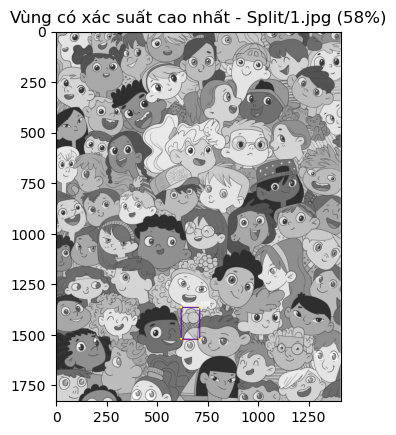

Đã lưu kết quả: result_2.jpg


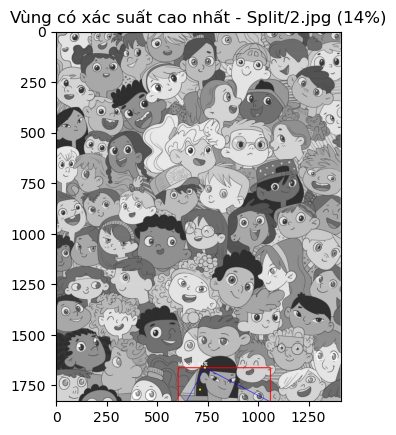

Đã lưu kết quả: result_3.jpg


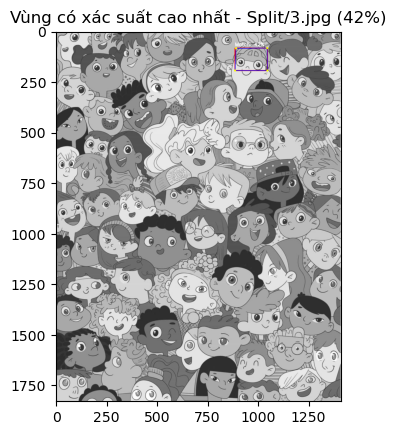

Đã lưu kết quả: result_4.jpg


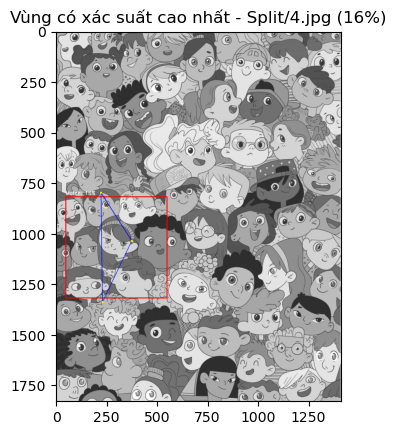

Đã lưu kết quả: result_5.jpg


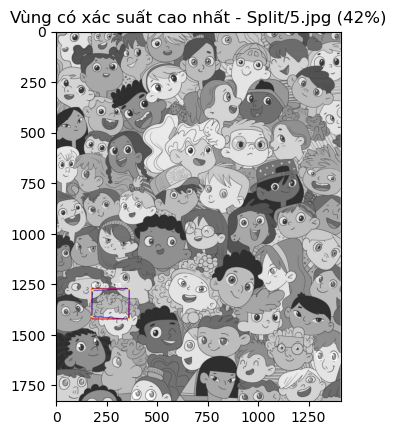

Đã lưu kết quả: result_6.jpg


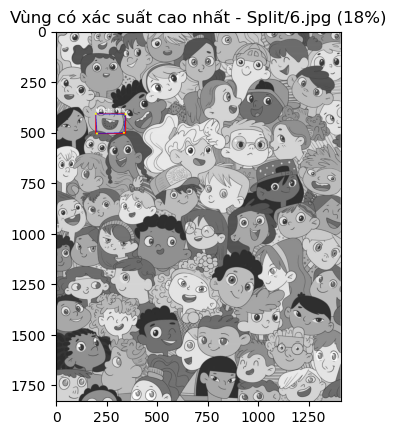

Đã lưu kết quả: result_7.jpg


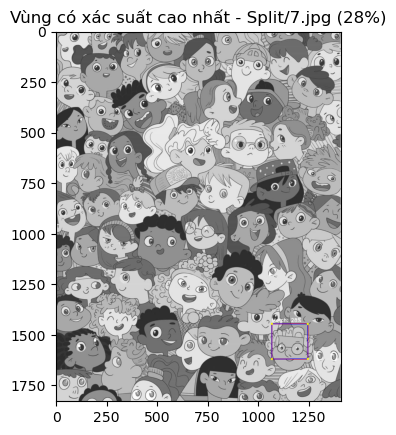

Đã lưu kết quả: result_8.jpg


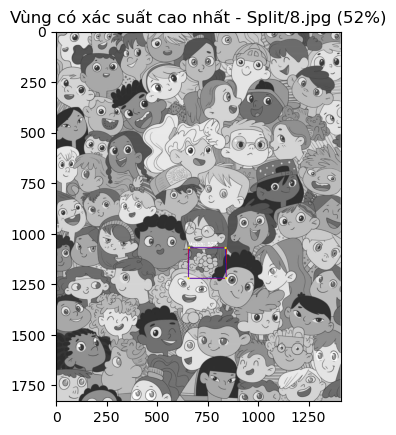

Đã lưu kết quả: result_9.jpg


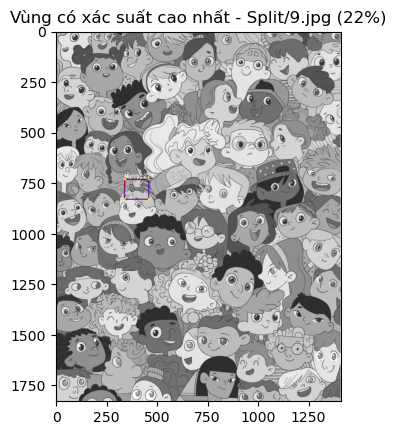

Đã lưu kết quả: result_10.jpg


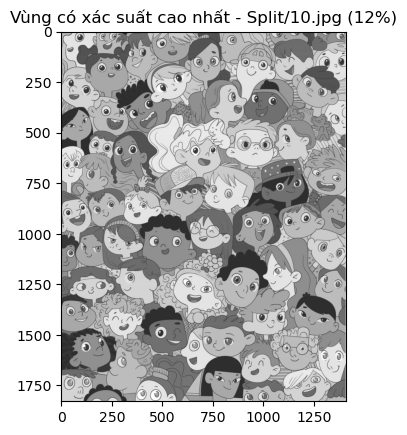

Đã lưu kết quả: result_11.jpg


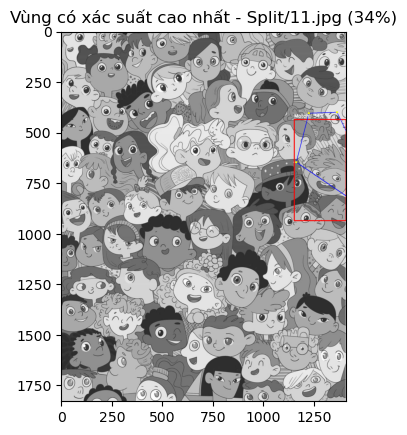

Đã lưu kết quả: result_12.jpg


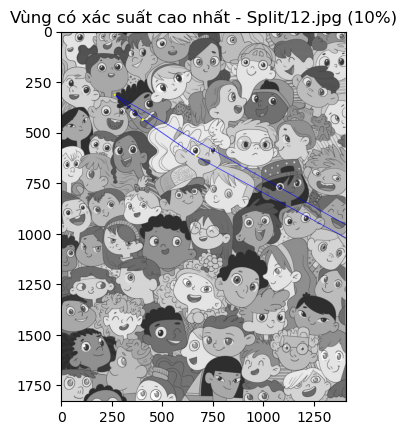

Đã lưu kết quả: result_13.jpg


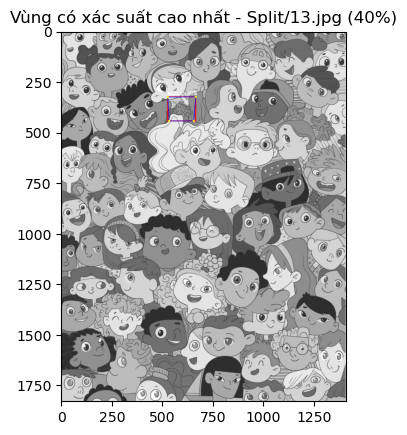

Đã lưu kết quả: result_14.jpg


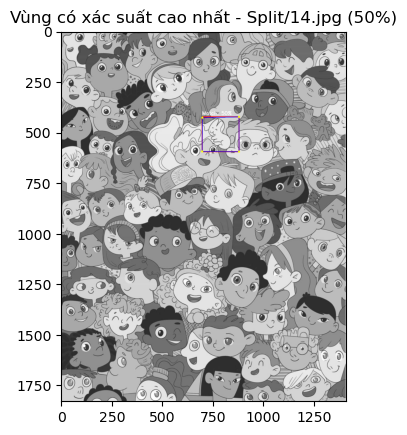

Đã lưu kết quả: result_15.jpg


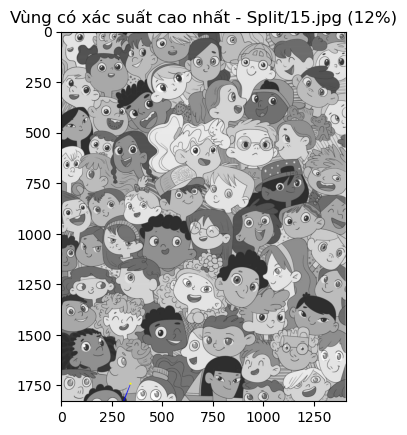

Đã lưu tọa độ vào file coordinates.csv.


In [47]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os

# Đọc ảnh lớn (ảnh nền)
img_large = cv2.imread("Split/left_part.jpg", cv2.IMREAD_GRAYSCALE)

if img_large is None:
    print("Lỗi: Không thể đọc ảnh lớn! Kiểm tra lại đường dẫn.")
    exit()

h_large, w_large = img_large.shape  # Kích thước ảnh lớn

# Khởi tạo SIFT
sift = cv2.SIFT_create()

# Tìm keypoints và descriptors của ảnh lớn
kp_large, des_large = sift.detectAndCompute(img_large, None)

if des_large is None:
    print("Không tìm thấy đặc trưng trong ảnh lớn.")
    exit()

# Tạo DataFrame lưu tọa độ
coordinates_df = pd.DataFrame(columns=['Image', 'Top_Left_X', 'Top_Left_Y', 'Bottom_Right_X', 'Bottom_Right_Y', 'Score'])

# Giới hạn kích thước tối đa
MAX_SIZE = 500

# Lặp qua từng ảnh cần tìm (1.jpg -> 15.jpg)
for i in range(1, 16):
    img_path = f"Split/{i}.jpg"
    img_template = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

    if img_template is None:
        print(f"Lỗi: Không thể đọc ảnh {img_path}")
        continue

    kp1, des1 = sift.detectAndCompute(img_template, None)

    if des1 is None:
        print(f"Không tìm thấy đặc trưng trong {img_path}")
        continue

    # FLANN Matcher
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=100)
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    des1 = np.float32(des1)
    des_large_float = np.float32(des_large)

    matches = flann.knnMatch(des1, des_large_float, k=2)

    # Lowe’s ratio test để lọc match tốt
    good_matches = [m for m, n in matches if m.distance < 0.75 * n.distance]

    if len(good_matches) >= 4:
        src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp_large[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

        if M is not None:
            h, w = img_template.shape
            corners = np.float32([[0, 0], [0, h], [w, h], [w, 0]]).reshape(-1, 1, 2)
            transformedCorners = cv2.perspectiveTransform(corners, M)

            best_corners = np.int32(transformedCorners)

            x_min, y_min = np.min(best_corners, axis=0)[0]
            x_max, y_max = np.max(best_corners, axis=0)[0]

            # Điều chỉnh kích thước tối đa 500x500 px
            width = x_max - x_min
            height = y_max - y_min

            if width > MAX_SIZE or height > MAX_SIZE:
                center_x = (x_min + x_max) // 2
                center_y = (y_min + y_max) // 2

                x_min = max(0, center_x - MAX_SIZE // 2)
                x_max = min(w_large, center_x + MAX_SIZE // 2)
                y_min = max(0, center_y - MAX_SIZE // 2)
                y_max = min(h_large, center_y + MAX_SIZE // 2)

            # Vẽ hình chữ nhật vùng tốt nhất
            img_result = cv2.cvtColor(img_large, cv2.COLOR_GRAY2BGR)
            cv2.rectangle(img_result, (x_min, y_min), (x_max, y_max), (0, 0, 255), 3)

            # 🎯 **Vẽ vùng nghi ngờ (Convex Hull)**
            hull = cv2.convexHull(best_corners)
            cv2.polylines(img_result, [hull], True, (255, 0, 0), 2)  # Đường nghi ngờ màu xanh

            # 🎯 **Hiển thị xác suất (%)**
            confidence = min(100, len(good_matches) * 2)  # Ước lượng xác suất dựa trên số match
            text = f"Match: {confidence}%"
            cv2.putText(img_result, text, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 255, 255), 2)

            # 🎯 **Đánh dấu điểm nghi ngờ**
            for pt in best_corners:
                x, y = pt[0]
                cv2.circle(img_result, (x, y), 5, (0, 255, 255), -1)  # Điểm nghi ngờ màu vàng

            new_row = pd.DataFrame([{
                'Image': f"{img_path}",
                'Top_Left_X': x_min,
                'Top_Left_Y': y_min,
                'Bottom_Right_X': x_max,
                'Bottom_Right_Y': y_max,
                'Score': confidence
            }])

            coordinates_df = pd.concat([coordinates_df, new_row], ignore_index=True)

            # Lưu ảnh kết quả
            output_path = f"result_{i}.jpg"
            cv2.imwrite(output_path, img_result)
            print(f"Đã lưu kết quả: {output_path}")

            plt.imshow(cv2.cvtColor(img_result, cv2.COLOR_BGR2RGB))
            plt.title(f"Vùng có xác suất cao nhất - {img_path} ({confidence}%)")
            plt.show()
        else:
            print(f"Không tìm thấy vùng chính xác trong {img_path}")
    else:
        print(f"Không đủ match tốt ({len(good_matches)}) trong {img_path}")

# Lưu tọa độ vào file CSV
coordinates_df.to_csv("coordinates.csv", index=False)
print("Đã lưu tọa độ vào file coordinates.csv.")


['Split\\1.jpg', 'Split\\2.jpg', 'Split\\3.jpg', 'Split\\4.jpg', 'Split\\5.jpg', 'Split\\6.jpg', 'Split\\7.jpg', 'Split\\8.jpg', 'Split\\9.jpg', 'Split\\1.jpg', 'Split\\10.jpg', 'Split\\11.jpg', 'Split\\12.jpg', 'Split\\13.jpg', 'Split\\14.jpg', 'Split\\15.jpg', 'Split\\2.jpg', 'Split\\3.jpg', 'Split\\4.jpg', 'Split\\5.jpg', 'Split\\6.jpg', 'Split\\7.jpg', 'Split\\8.jpg', 'Split\\9.jpg']


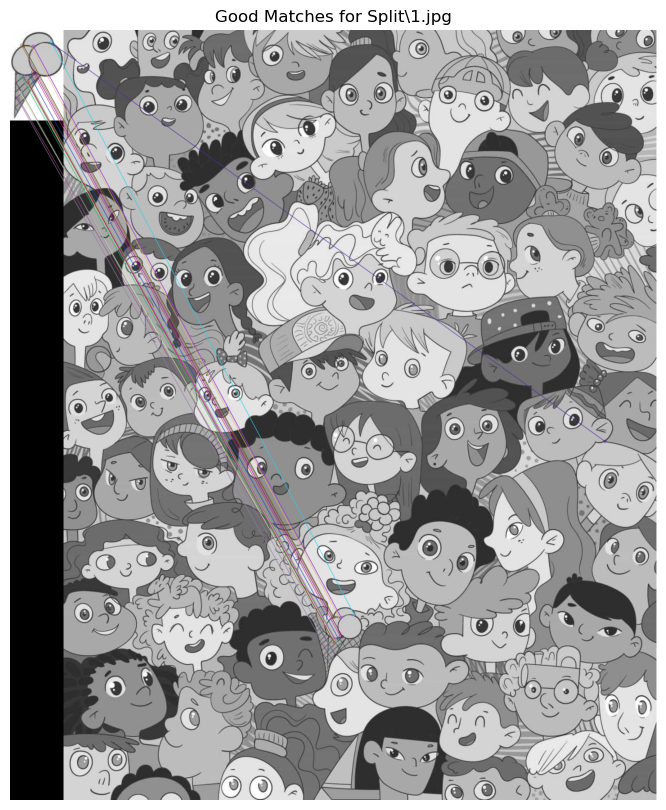

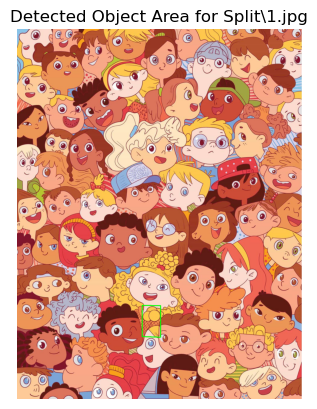

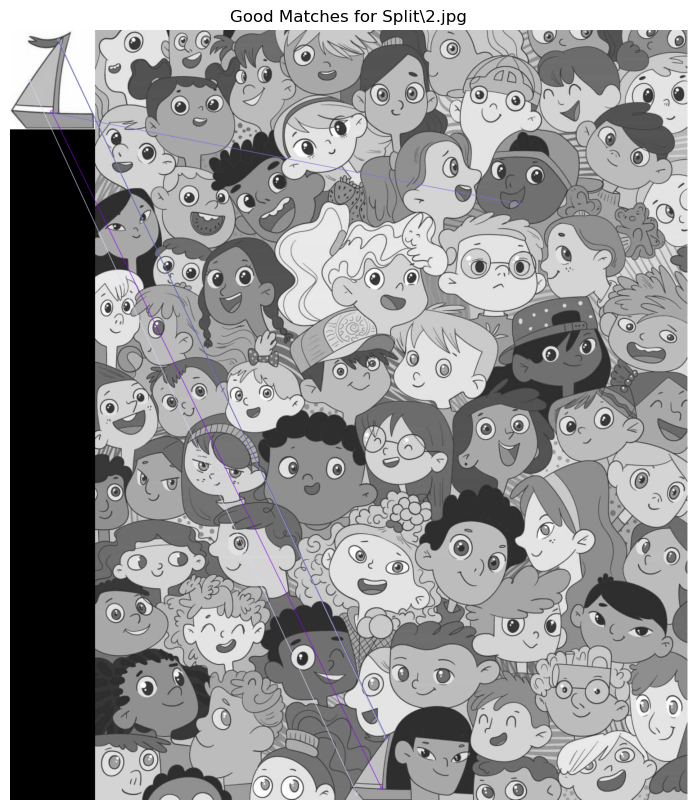

Not enough good matches for Split\2.jpg


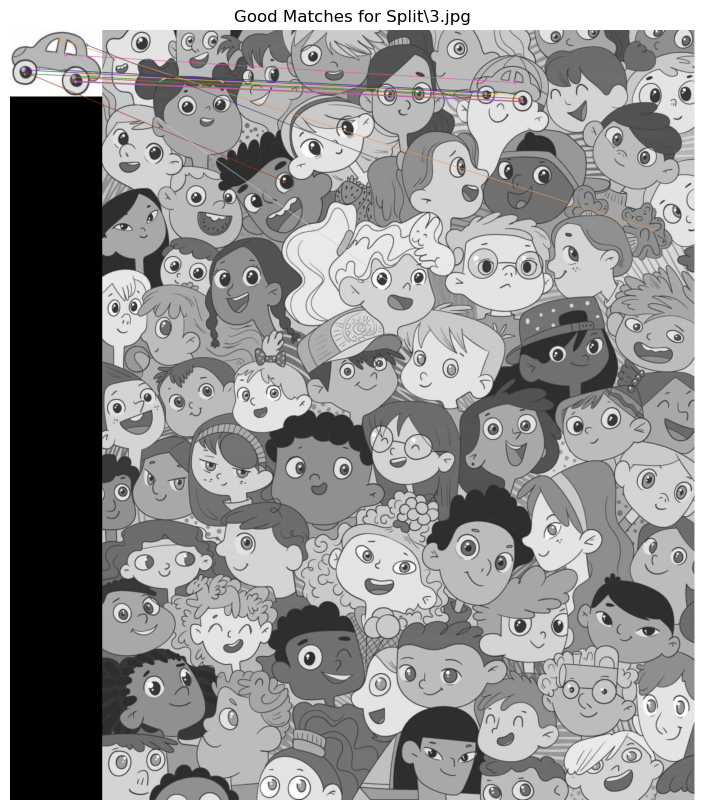

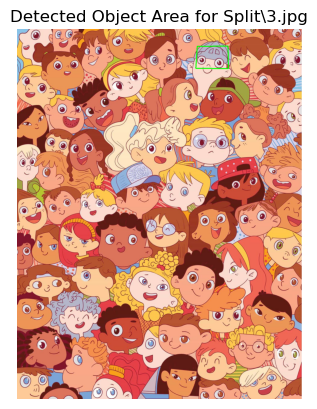

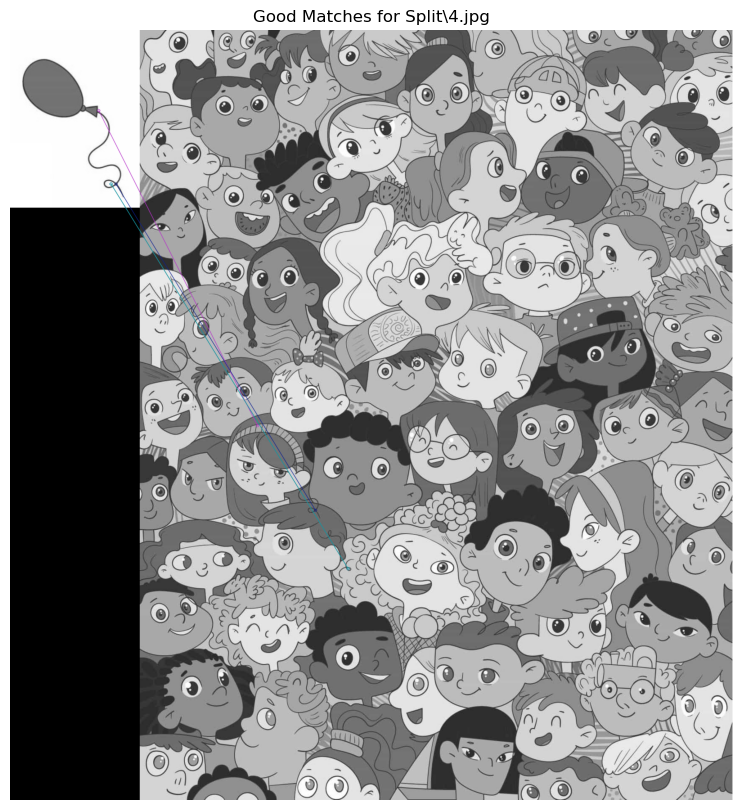

Not enough good matches for Split\4.jpg


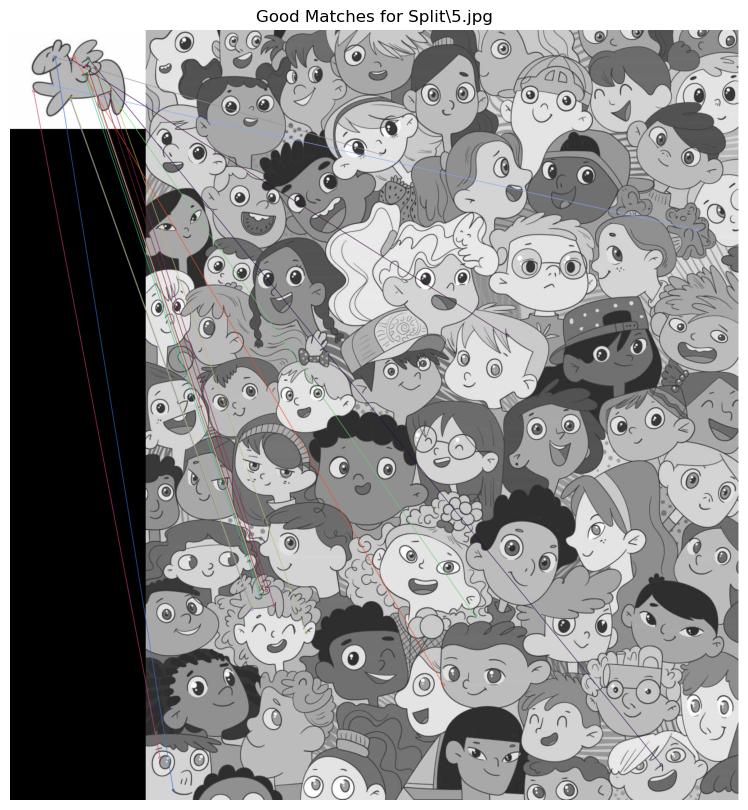

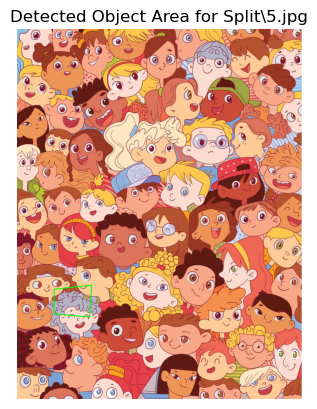

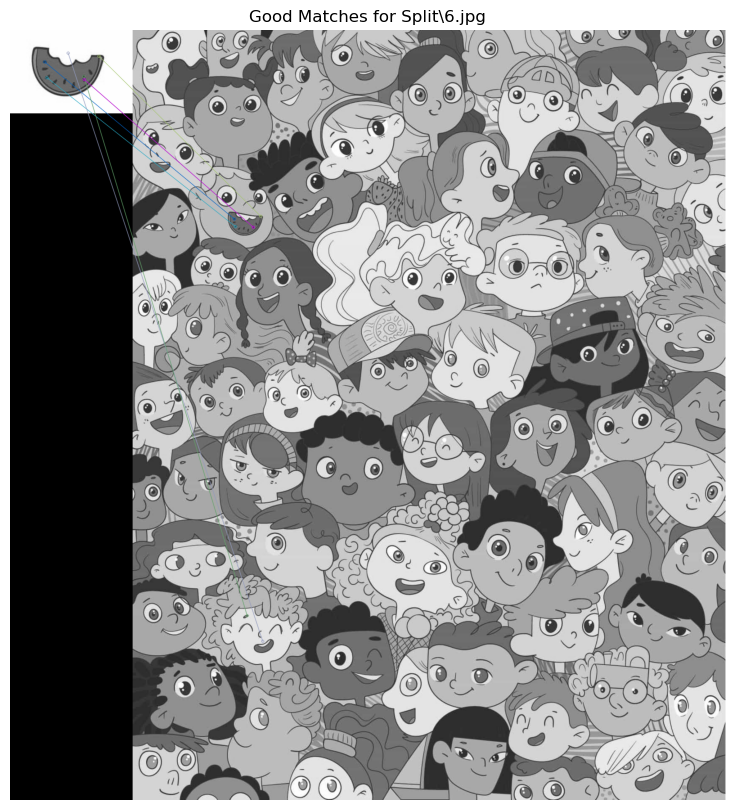

Not enough good matches for Split\6.jpg


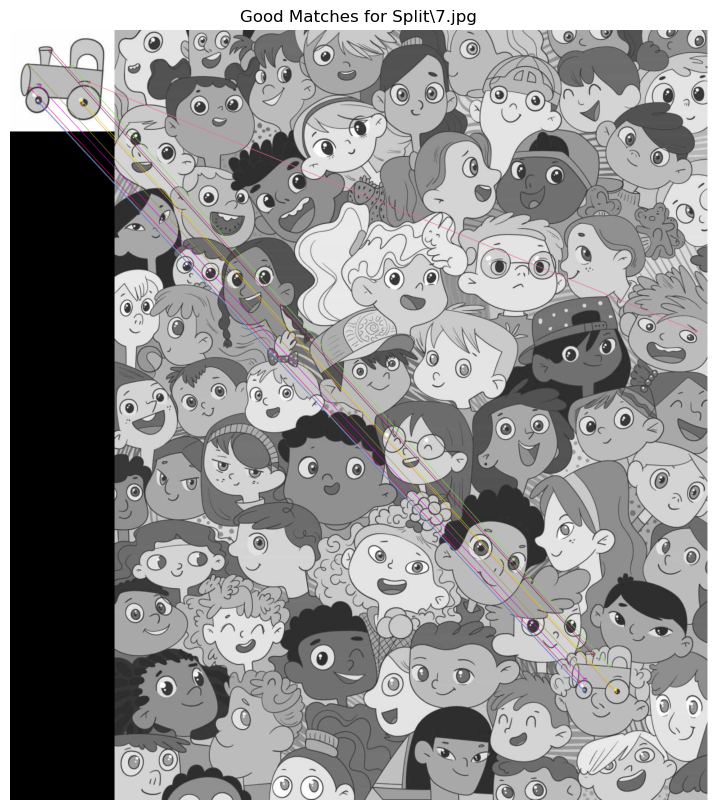

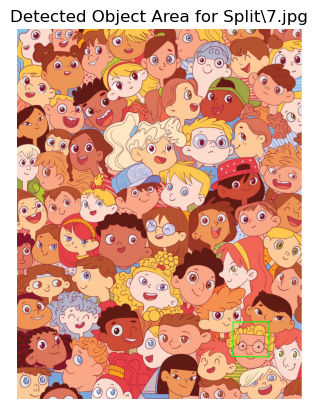

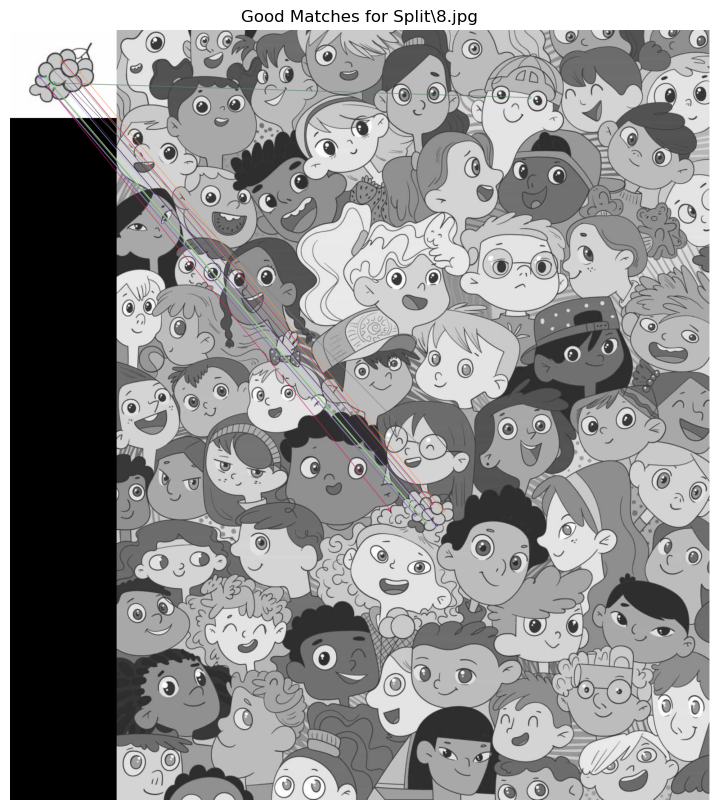

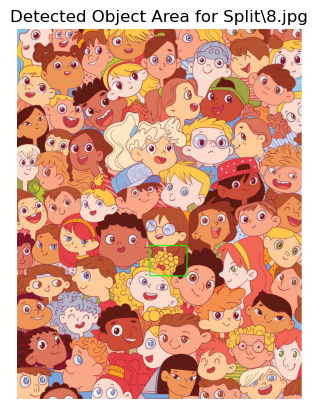

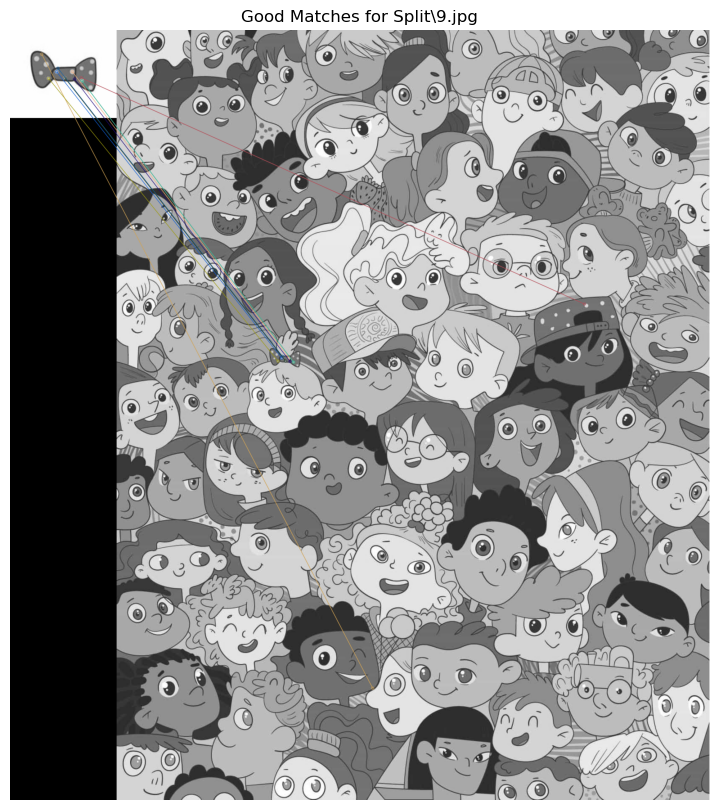

Not enough good matches for Split\9.jpg


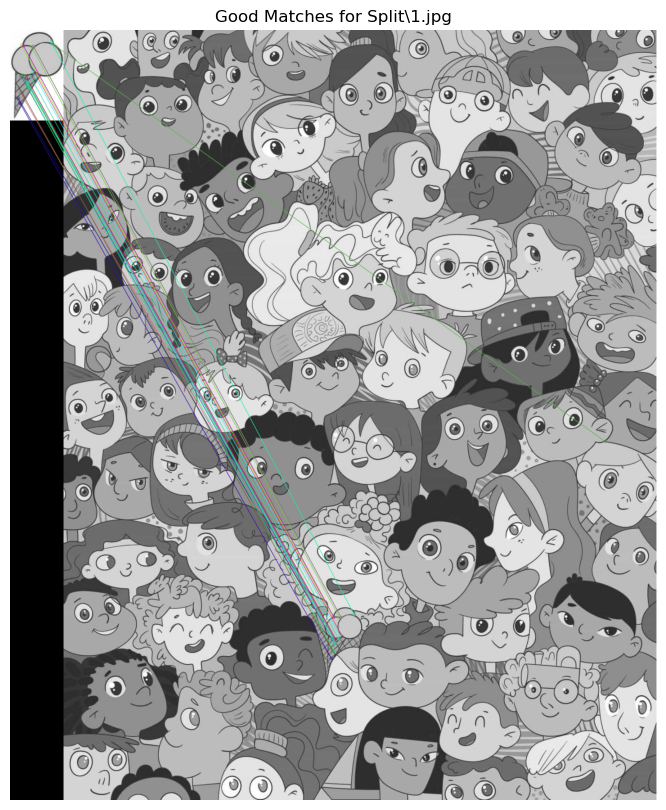

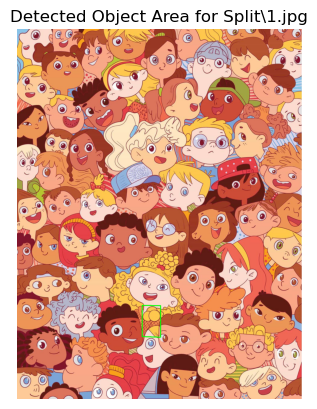

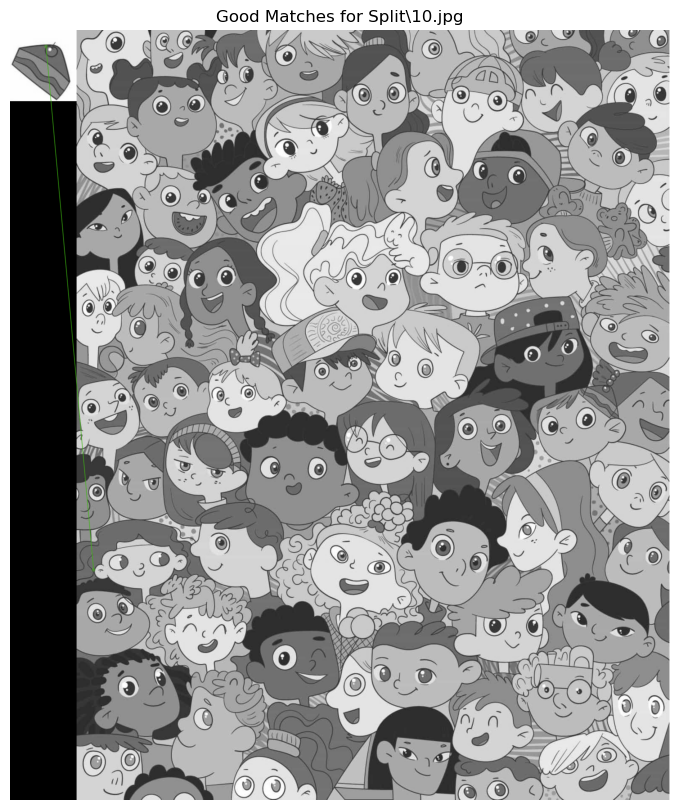

Not enough good matches for Split\10.jpg


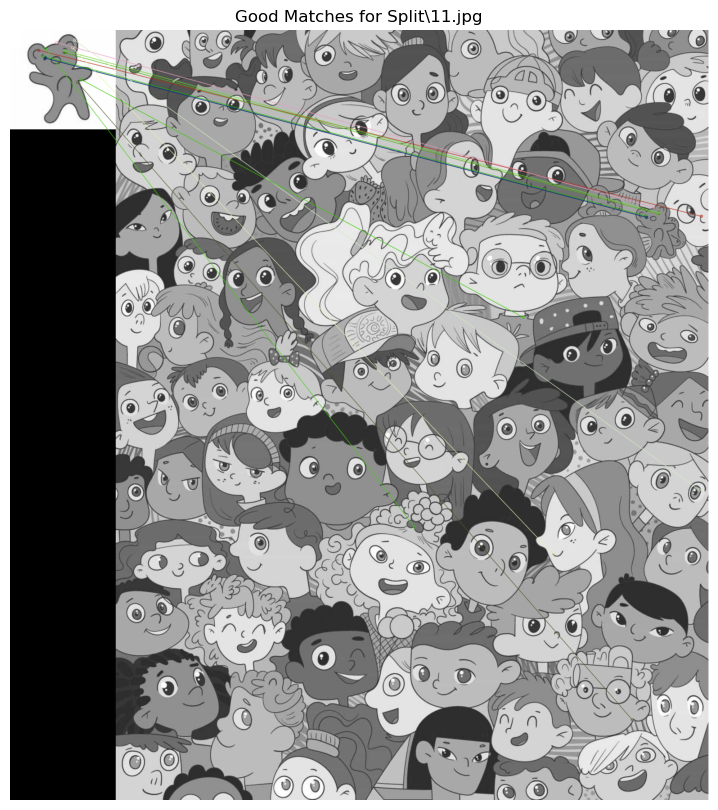

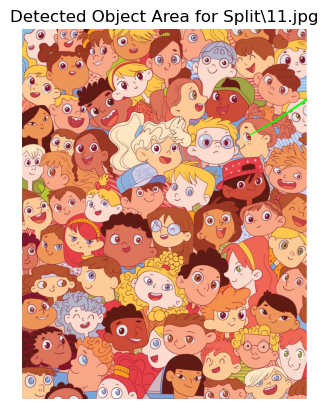

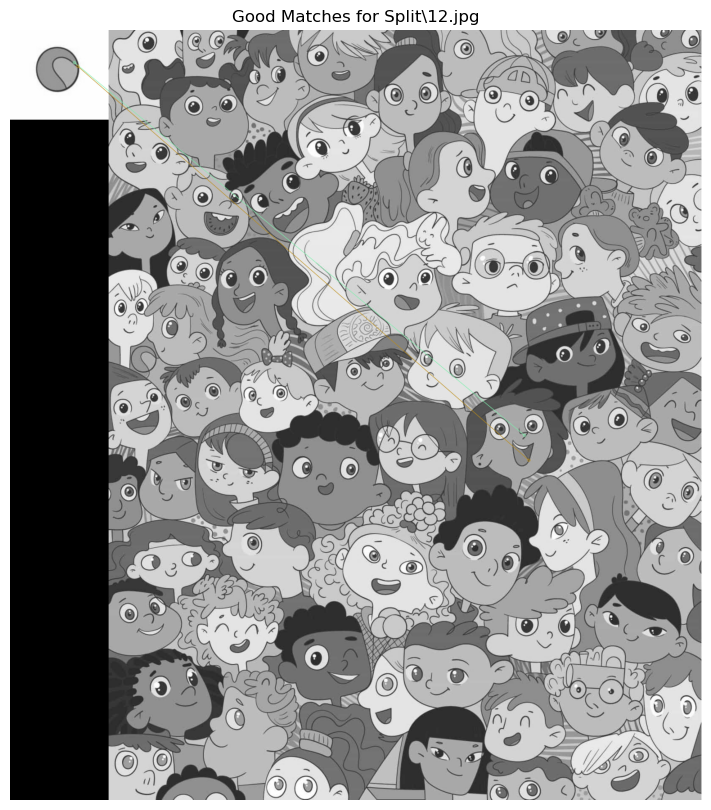

Not enough good matches for Split\12.jpg


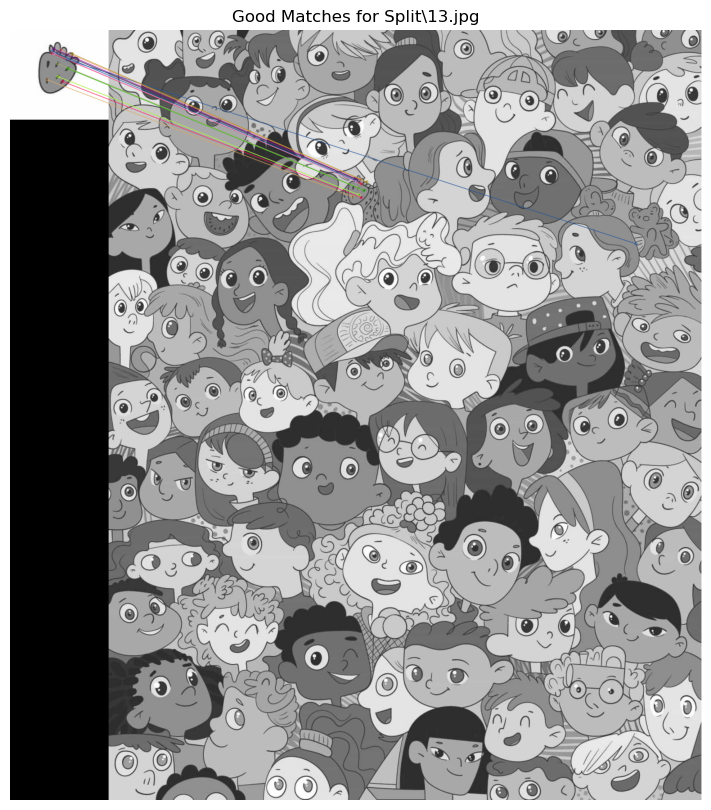

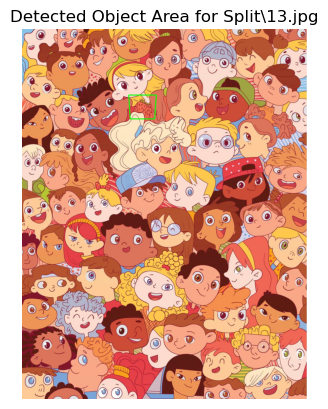

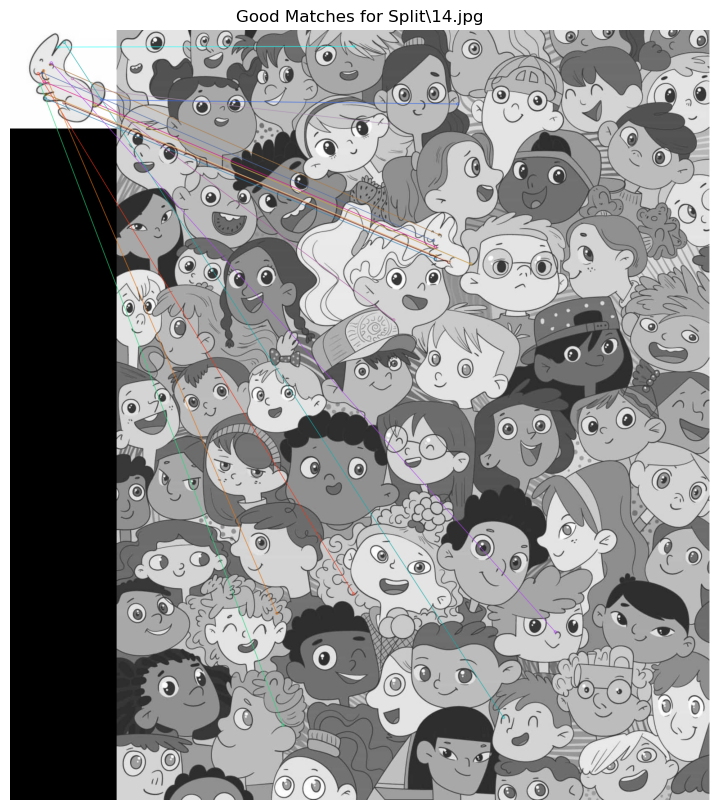

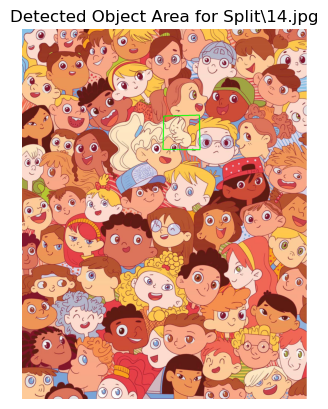

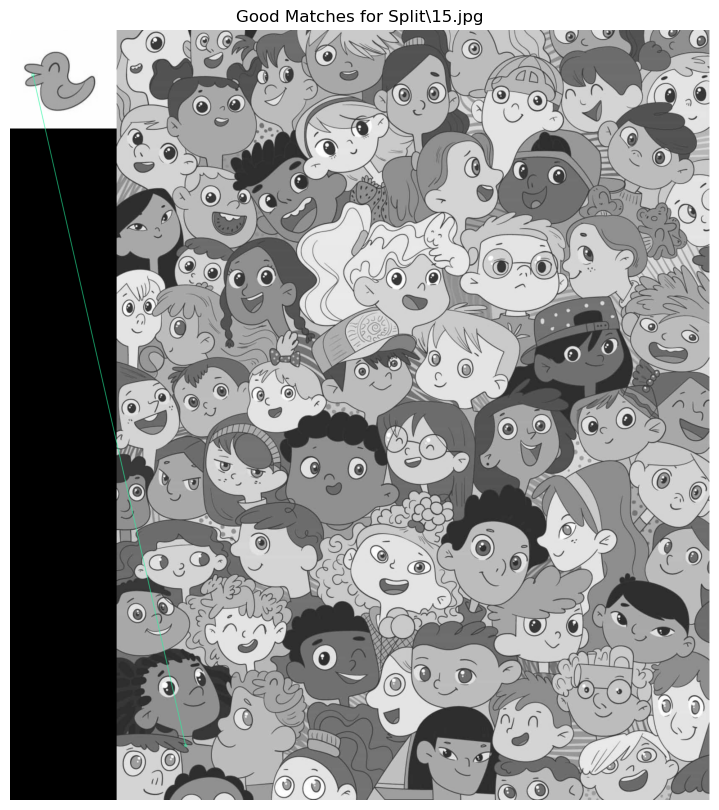

Not enough good matches for Split\15.jpg


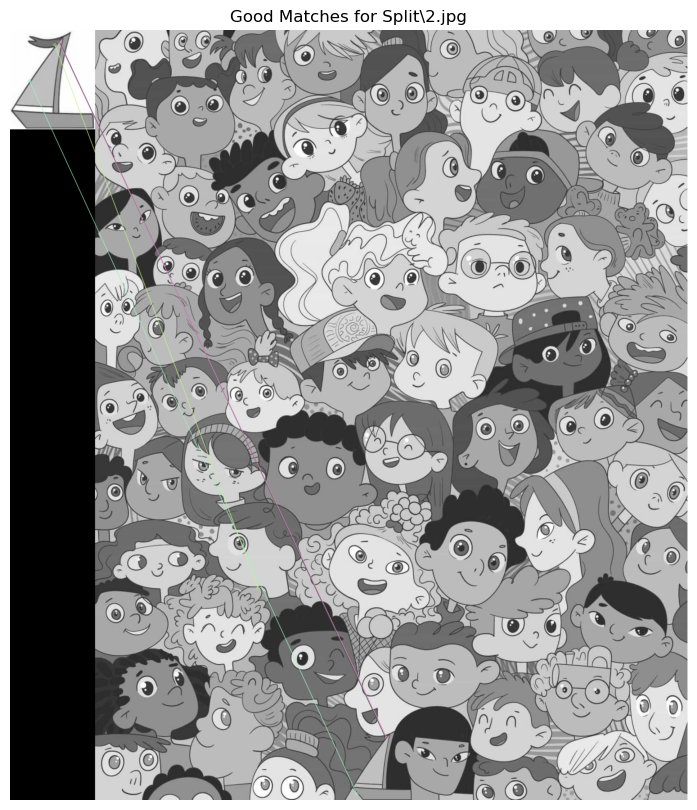

Not enough good matches for Split\2.jpg


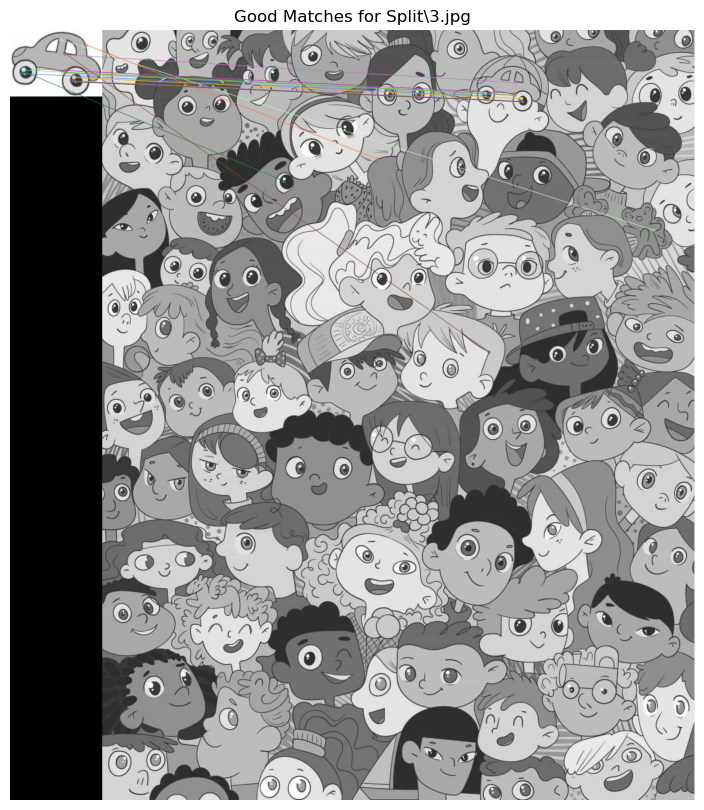

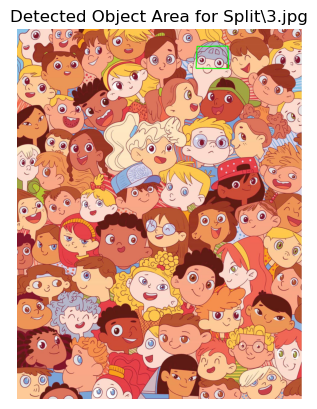

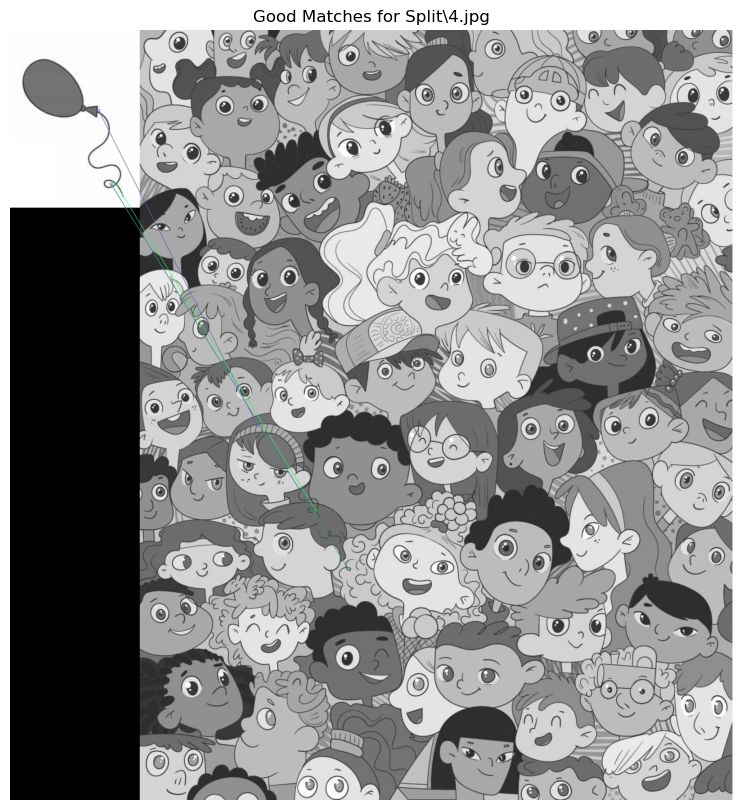

Not enough good matches for Split\4.jpg


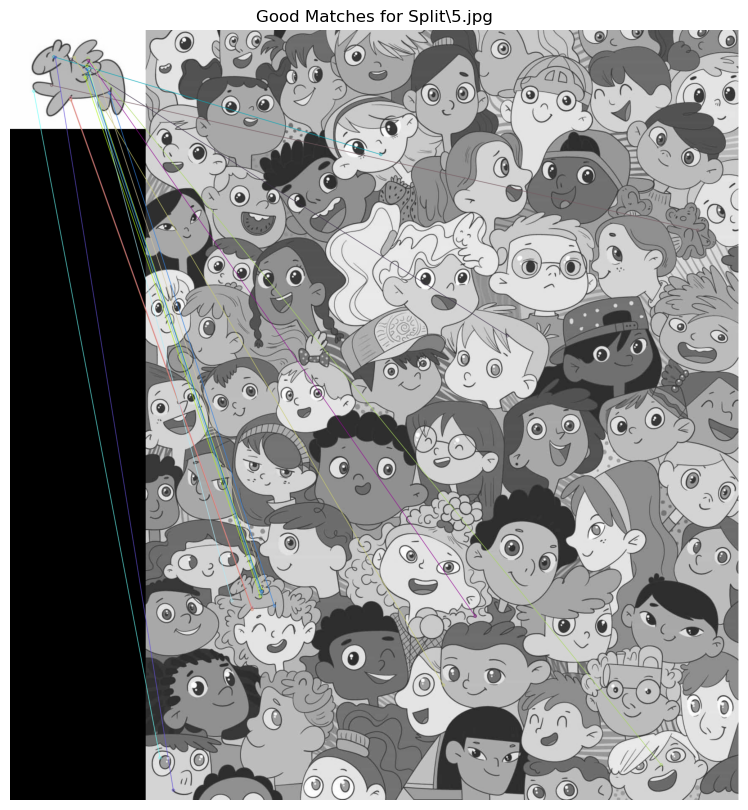

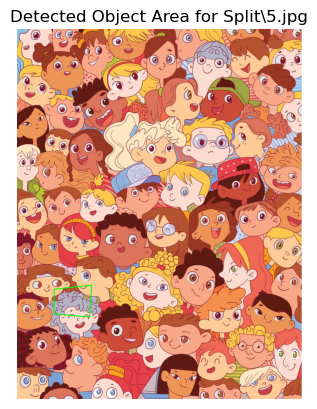

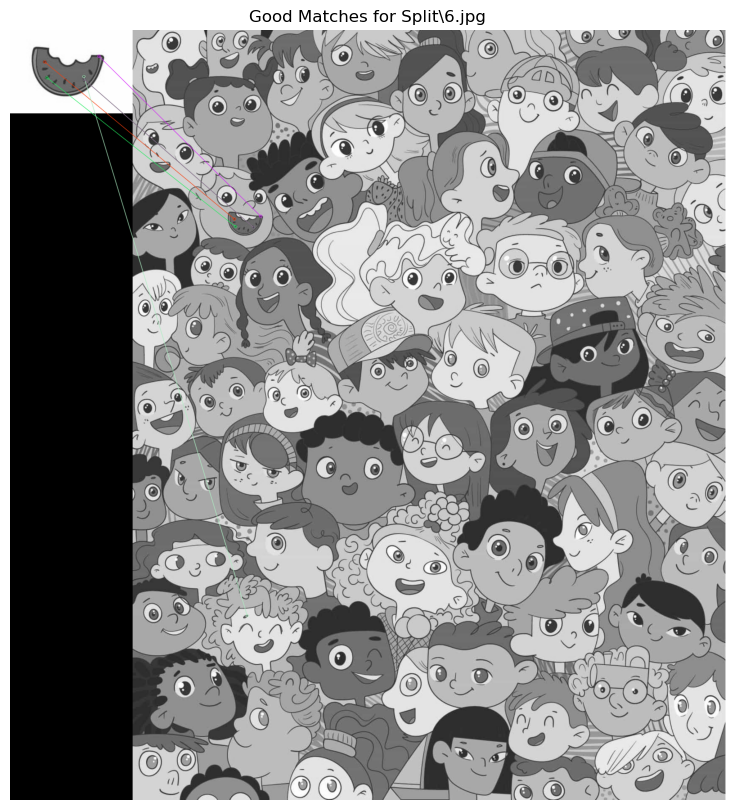

Not enough good matches for Split\6.jpg


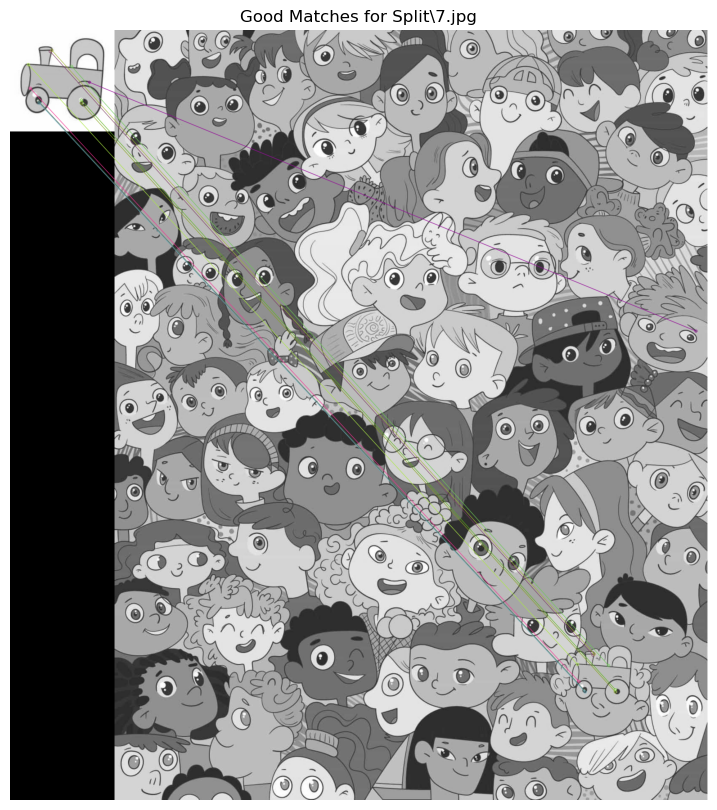

Not enough good matches for Split\7.jpg


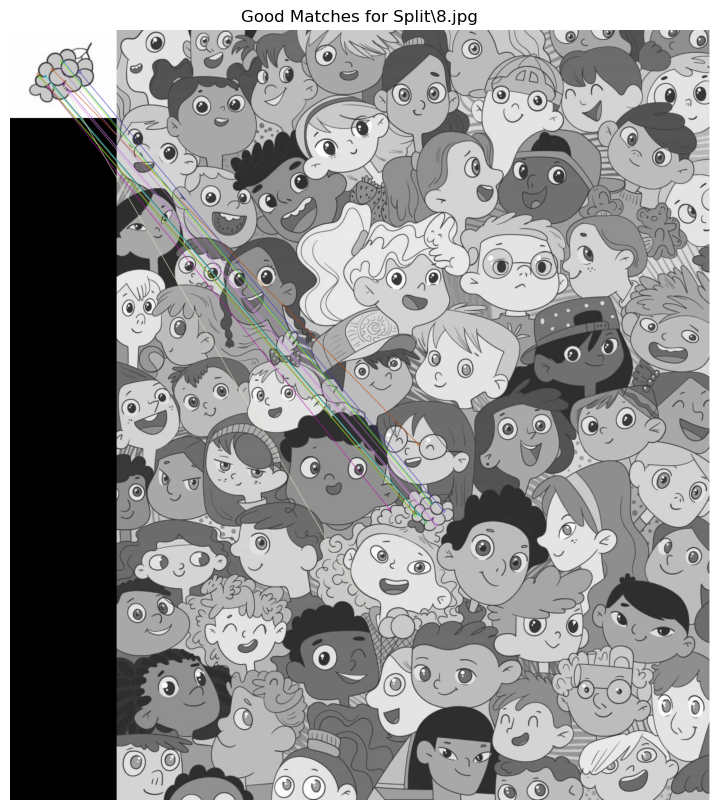

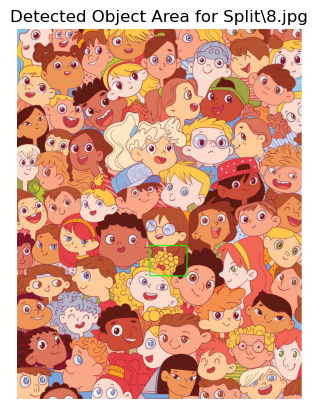

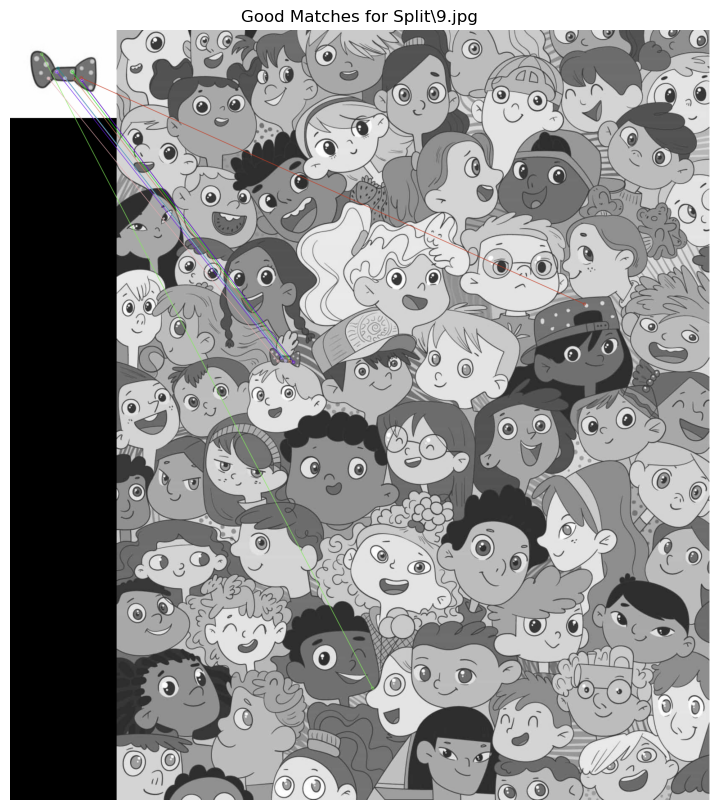

Not enough good matches for Split\9.jpg


In [65]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import glob

# Đọc ảnh mẫu và ảnh lớn
img_large = cv2.imread("Split/left_part.jpg", cv2.IMREAD_GRAYSCALE)

# Khởi tạo SIFT
sift = cv2.SIFT_create()

# Danh sách các ảnh cần tìm (1.jpg, 2.jpg, ..., 15.jpg)
image_paths = sorted(glob.glob("Split/[1-9].jpg")) + sorted(glob.glob("Split/[1-9]*.jpg"))
print(image_paths)

for image_path in image_paths:
    img_template = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    
    # Phát hiện điểm đặc trưng và mô tả trong ảnh mẫu và ảnh cần tìm
    kp1, des1 = sift.detectAndCompute(img_template, None)
    kp2, des2 = sift.detectAndCompute(img_large, None)
    
    # Sử dụng FLANN để so khớp các điểm đặc trưng
    index_params = dict(algorithm=1, trees=5)  # FLANN với KDTree
    search_params = dict(checks=50)  # Số lần kiểm tra khi tìm kiếm

    flann = cv2.FlannBasedMatcher(index_params, search_params)

    # Khớp các mô tả
    matches = flann.knnMatch(des1, des2, k=2)

    # Áp dụng Lowe's ratio test để lọc các kết quả tốt
    good_matches = []
    for m, n in matches:
        if m.distance < 0.7 * n.distance:
            good_matches.append(m)

    # Vẽ các điểm khớp
    img_result = cv2.drawMatches(img_template, kp1, img_large, kp2, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    # Hiển thị ảnh kết quả
    plt.figure(figsize=(10, 10))
    plt.imshow(img_result)
    plt.title(f"Good Matches for {image_path}")
    plt.axis('off')
    plt.show()

    # Nếu đủ số lượng khớp tốt, tìm Homography và vẽ vùng
    if len(good_matches) > 10:
        src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
        
        if M is not None:
            h, w = img_template.shape
            corners = np.float32([[0, 0], [0, h-1], [w-1, h-1], [w-1, 0]]).reshape(-1, 1, 2)
            transformed_corners = cv2.perspectiveTransform(corners, M)

            img_large_color = cv2.imread("Split/left_part.jpg")  # Đọc lại ảnh màu
            img_large_color = cv2.polylines(img_large_color, [np.int32(transformed_corners)], True, (0, 255, 0), 3)

            # Hiển thị ảnh với vùng khớp
            plt.imshow(cv2.cvtColor(img_large_color, cv2.COLOR_BGR2RGB))
            plt.title(f"Detected Object Area for {image_path}")
            plt.axis('off')
            plt.show()
        else:
            print(f"No Homography for {image_path}")
    else:
        print(f"Not enough good matches for {image_path}")


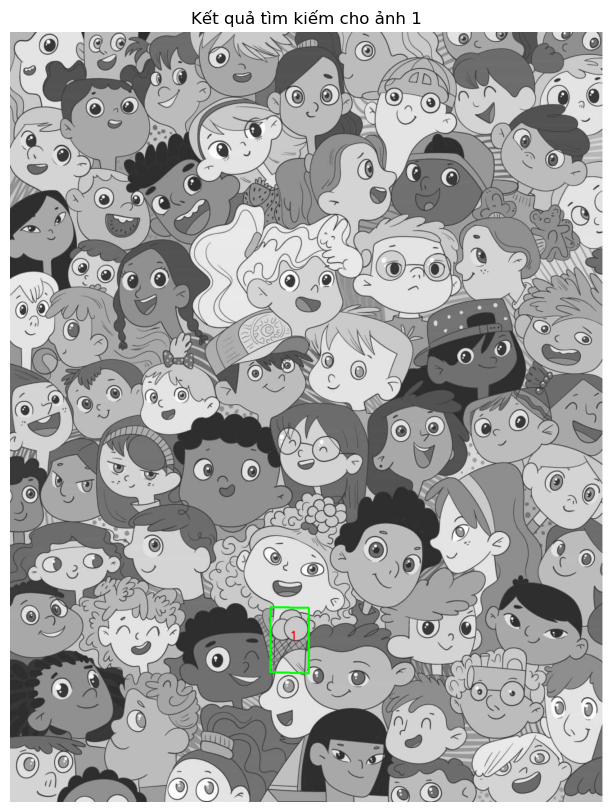

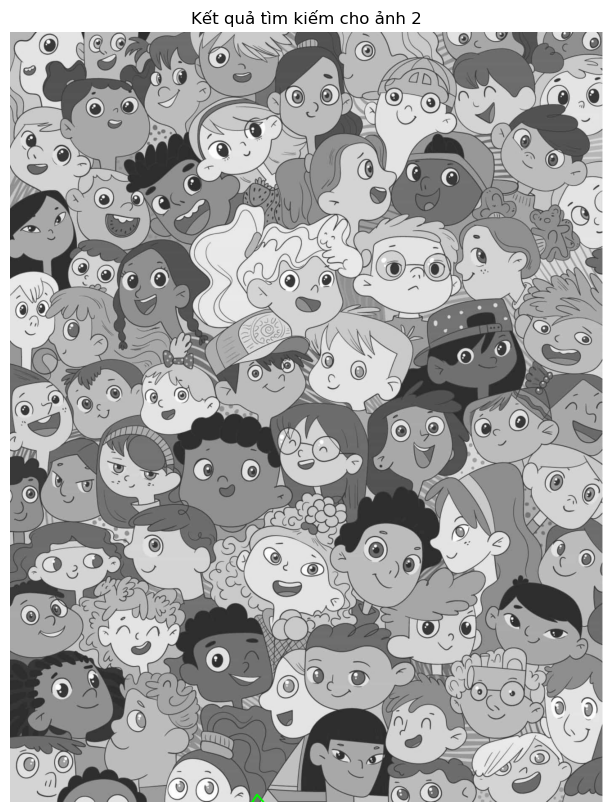

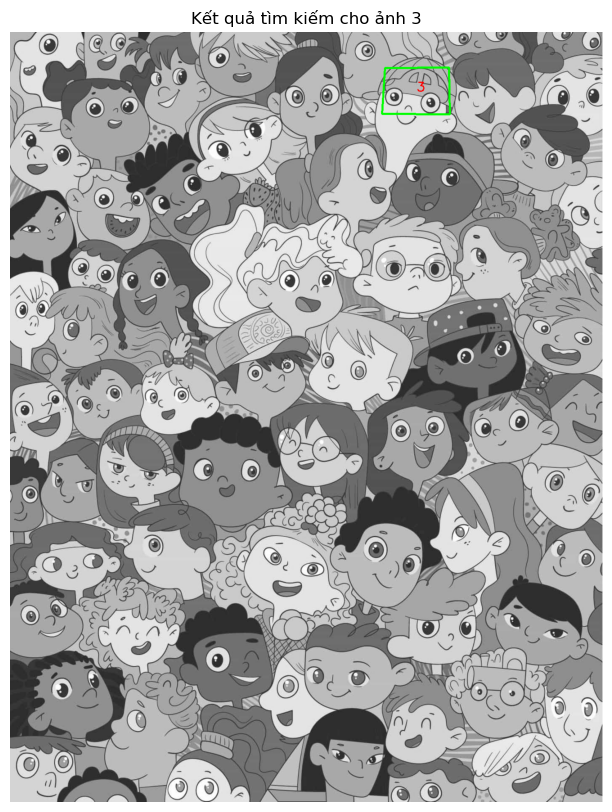

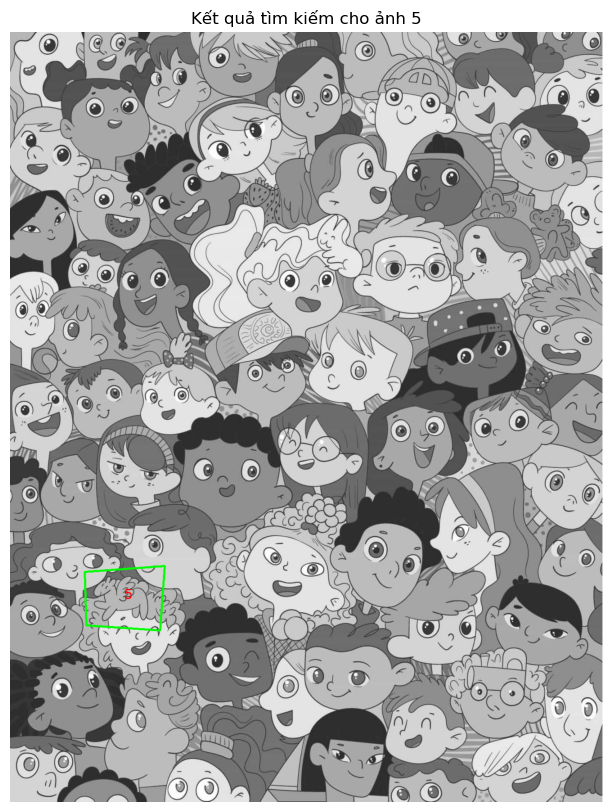

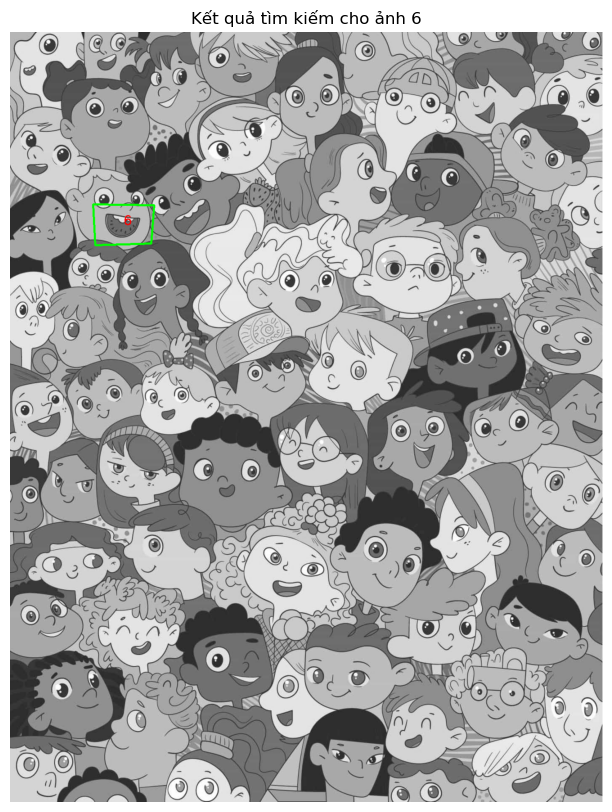

...

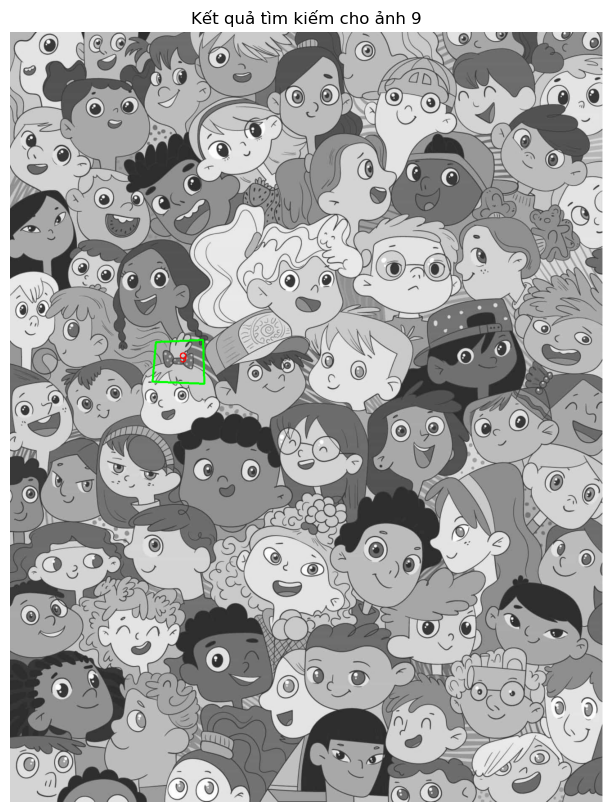

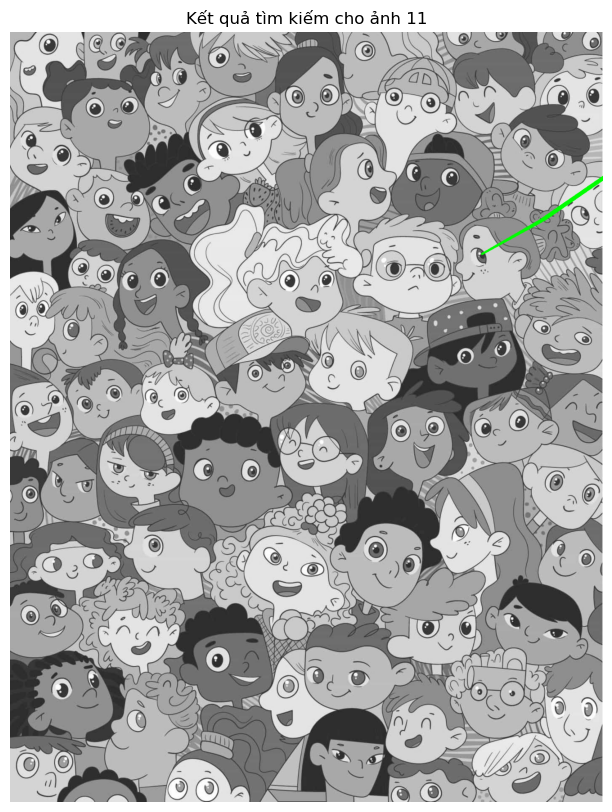

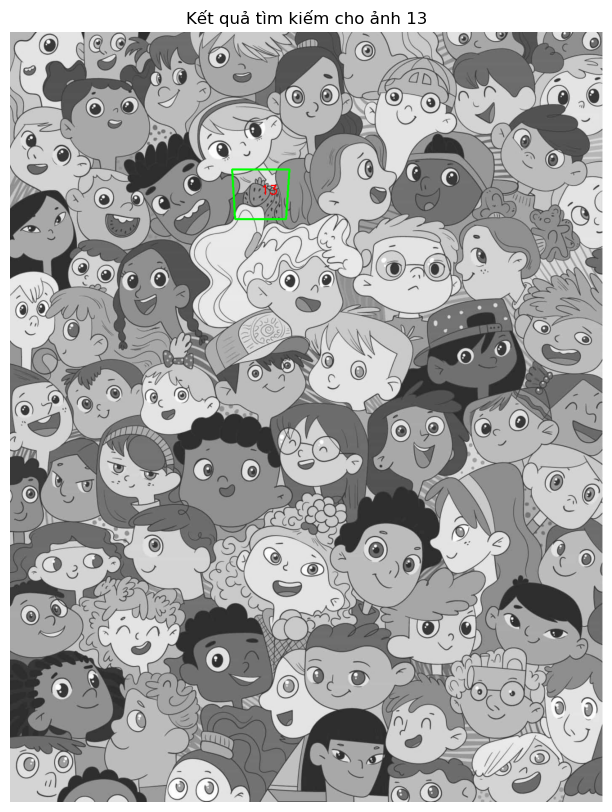

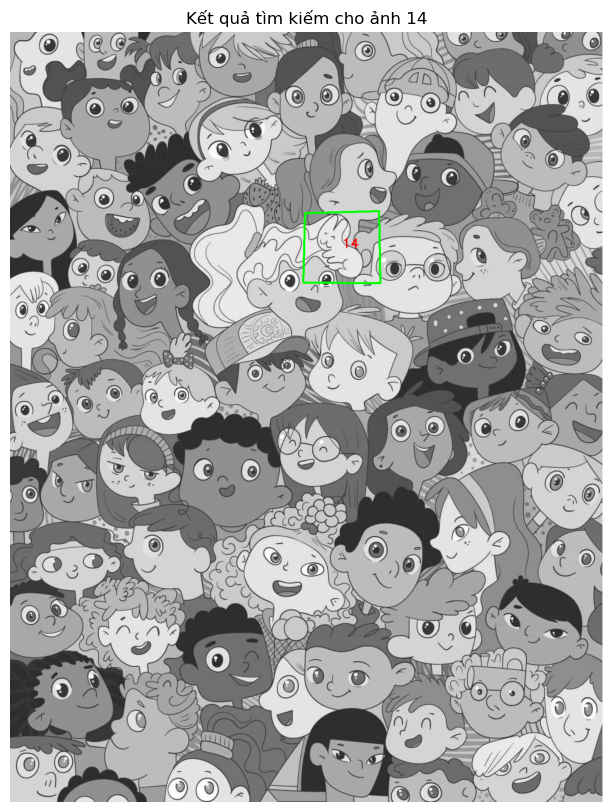

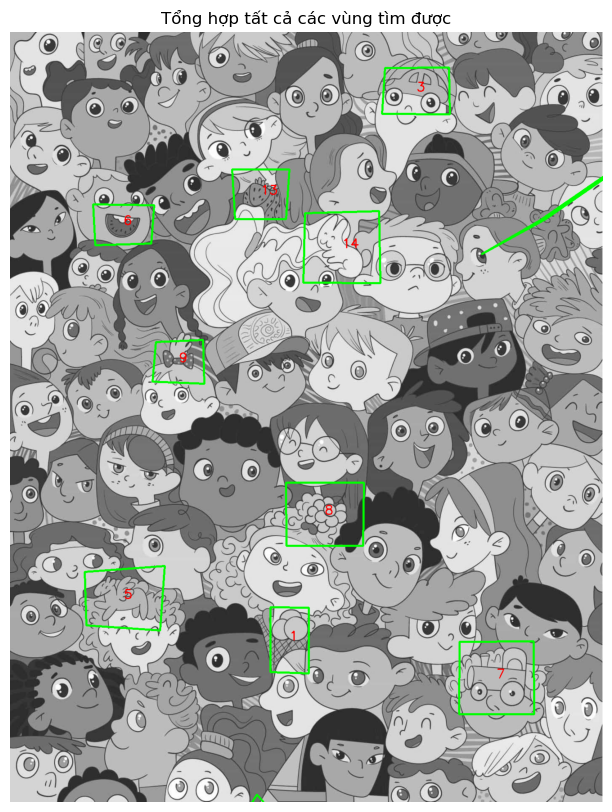

True

In [114]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import glob
import os

# Đọc ảnh lớn và chuyển sang ảnh xám
img_large = cv2.imread("Split/left_part.jpg", cv2.IMREAD_GRAYSCALE)  # Ảnh lớn xám
sift = cv2.SIFT_create()

# Danh sách các ảnh cần tìm (1.jpg, 2.jpg, ..., 15.jpg)
image_paths = sorted(glob.glob("Split/[1-9].jpg") + glob.glob("Split/1[0-5].jpg"), key=lambda x: int(os.path.basename(x).split('.')[0]))

# Ảnh lớn để tổng hợp tất cả các vùng tìm thấy
img_large_final = cv2.cvtColor(img_large, cv2.COLOR_GRAY2BGR)

for image_path in image_paths:
    img_large_color = cv2.cvtColor(img_large, cv2.COLOR_GRAY2BGR)  # Reset ảnh lớn trước khi xử lý từng ảnh
    img_template = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Đọc ảnh mẫu xám
    img_number = int(os.path.basename(image_path).split('.')[0])  # Lấy số từ tên file
    
    # Phát hiện các điểm đặc trưng và mô tả
    kp1, des1 = sift.detectAndCompute(img_template, None)
    kp2, des2 = sift.detectAndCompute(img_large, None)

    # Sử dụng FLANN để khớp các điểm đặc trưng
    index_params = dict(algorithm=1, trees=5)
    search_params = dict(checks=50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    # Khớp các mô tả
    matches = flann.knnMatch(des1, des2, k=2)

    # Áp dụng Lowe's ratio test để lọc các khớp không tốt
    good_matches = [m for m, n in matches if m.distance < 0.7 * n.distance]

    # Kiểm tra số lượng khớp tốt
    if len(good_matches) > 4:  # Chỉ tính khi có đủ khớp tốt
        src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

        # Tính Homography
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

        # Nếu có homography, vẽ các vùng khớp lên ảnh lớn
        if M is not None:
            h, w = img_template.shape[:2]
            corners = np.float32([[0, 0], [0, h-1], [w-1, h-1], [w-1, 0]]).reshape(-1, 1, 2)
            transformed_corners = cv2.perspectiveTransform(corners, M)

            # Vẽ hình chữ nhật lên ảnh lớn
            img_large_color = cv2.polylines(img_large_color, [np.int32(transformed_corners)], True, (0, 255, 0), 3)
            img_large_final = cv2.polylines(img_large_final, [np.int32(transformed_corners)], True, (0, 255, 0), 3)

            # Đánh số theo tên ảnh
            center = np.mean(transformed_corners, axis=0).astype(int).flatten()
            cv2.putText(img_large_color, str(img_number), tuple(center), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2)
            cv2.putText(img_large_final, str(img_number), tuple(center), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2)

        # Lưu kết quả cho ảnh hiện tại
        output_image_path = f"result_{img_number}.jpg"
        cv2.imwrite(output_image_path, img_large_color)

        # Hiển thị ảnh
        plt.figure(figsize=(10, 10))
        plt.imshow(img_large_color, cmap='gray')
        plt.title(f"Kết quả tìm kiếm cho ảnh {img_number}")
        plt.axis('off')
        plt.show()

# Hiển thị ảnh tổng hợp cuối cùng
plt.figure(figsize=(10, 10))
plt.imshow(img_large_final, cmap='gray')
plt.title("Tổng hợp tất cả các vùng tìm được")
plt.axis('off')
plt.show()

# Lưu ảnh cuối cùng
cv2.imwrite('result_combined_final.jpg', img_large_final)
